In [66]:
import pandas as pd
import numpy as np
np.random.seed(201)
import matplotlib.pyplot as plt
import statsmodels.api as sm

%matplotlib inline
#from ISLP import load_data
from sklearn.preprocessing import scale
from sklearn.linear_model import Lasso, LassoCV, Ridge, RidgeCV
from sklearn.metrics import mean_squared_error
from sklearn import datasets
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score, recall_score
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import RocCurveDisplay
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import KFold
from tabulate import tabulate
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
import seaborn as sns
import statistics

Parte I

1. En pdf

2. descargar base de datos y filtrar por Baires

In [2]:
# Cargamos la data
data_ind = pd.read_excel("usu_individual_T123.xlsx")
data_hog = pd.read_excel("usu_hogar_T123.xlsx")

In [67]:
data_ind_baires = data_ind[data_ind['AGLOMERADO'].isin([32, 33])]
data_hog_baires = data_hog[data_hog['AGLOMERADO'].isin([32, 33])]

3. Unir las dos bases

In [68]:
data_unida = pd.merge(data_ind_baires, data_hog_baires, on=['CODUSU','NRO_HOGAR'], how='outer')
# Seleccionar las columnas que tienen el sufijo a borrar
variables_duplicadas = data_unida.filter(like='_y', axis=1)

# Borrar las columnas seleccionadas del DataFrame
data_unida = data_unida.drop(variables_duplicadas.columns, axis=1)

4. Limpieza de base datos

In [69]:
# Borramos todas las variables que tienen mas del 50% de missings
proporcion_missing_values = data_unida.isnull().mean()

# Filtra las columnas que tienen más del 50% de missing values
#   todas las variabels relacionadas los desocupados tienen mas del 70% de NaN
#   todas las variables relacionadas a los ocupados tienen mas del 50% de NaN
#   Tambien eliminamos las variables relacioandas a la categoria otros y CH14 que se refiere al ultimo año que aprobó pero ya tenemos nivel educativo
columnas_50_missing = proporcion_missing_values[proporcion_missing_values > 0.5].index
print(columnas_50_missing)
# Eliminar las columnas seleccionadas del DataFrame
data_unida_drop50 = data_unida.drop(columnas_50_missing, axis=1)

data_unida_drop50['CH08'].fillna(9, inplace=True)
# solo reemplazamos esta variable con NS/NR  ya que solo tiene un missing value.
# P47T tiene 24 missing values pero es una variable de ingreso y luego será eliminada

data_unida_drop50['CH08'] = data_unida_drop50['CH08'].astype('int64')

Index(['CH14', 'CH15_COD', 'CH16_COD', 'IMPUTA', 'PP03C', 'PP03D', 'PP3E_TOT',
       'PP3F_TOT', 'PP03G', 'PP03H',
       ...
       'PDECINDR', 'IDECIFR_x', 'PDECIFR_x', 'IDECCFR_x', 'PDECCFR_x',
       'IV1_ESP', 'IV3_ESP', 'IV7_ESP', 'II7_ESP', 'II8_ESP'],
      dtype='object', length=107)


5. impieza de base datos

In [70]:
variables_a_verificar = ['IV2','II1','IX_TOT','IX_MEN10','IX_MAYEQ10','ITF_x','CH06','CH12','NIVEL_ED']
# vemos que CH6=Edad tiene valores negativos, por lo tanto se elimina esas observaciones
# asi como las observaciones que tienen 99 en variables numericas discretas que claramente son missing. Edad puede ser 99
data_unida_drop50[variables_a_verificar].describe().T

,count,mean,std,min,25%,50%,75%,max
IV2,7619.0,3.075338,1.933210,1.0,2.0,3.0,4.0,99.0
II1,7619.0,3.056307,1.928454,0.0,2.0,3.0,4.0,99.0
IX_TOT,7619.0,3.696417,1.852985,1.0,2.0,4.0,5.0,13.0
IX_MEN10,7619.0,0.601391,0.947037,0.0,0.0,0.0,1.0,8.0
IX_MAYEQ10,7619.0,3.095026,1.441937,1.0,2.0,3.0,4.0,10.0
ITF_x,7619.0,138407.892637,334941.671900,0.0,0.0,75000.0,200000.0,10990000.0
CH06,7619.0,37.177845,22.738454,-1.0,18.0,35.0,55.0,99.0
CH12,7619.0,4.093451,2.942823,0.0,2.0,4.0,6.0,99.0
NIVEL_ED,7619.0,3.799842,1.746307,1.0,3.0,4.0,5.0,7.0


<Axes: xlabel='variable', ylabel='value'>

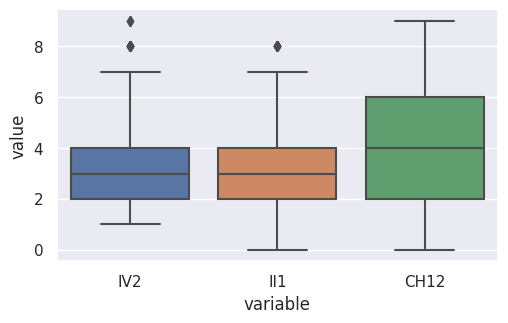

In [71]:
# Chequeamos variables numericas discretas con 99
variables_a_verificar = ['IV2','II1','CH12']  # Lista de variables a verificar
# Utiliza el método drop para eliminar las filas que cumplan con la condición
data_unida_drop50 = data_unida_drop50.drop(data_unida_drop50[(data_unida_drop50[variables_a_verificar] == 99).any(axis=1)].index)

sns.set(rc={'figure.figsize':(5.7,3.27)})
sns.boxplot(x="variable", y="value", data=pd.melt(data_unida_drop50[variables_a_verificar]))

In [72]:
# Obervaciones con valores negativos en variables que no corresponde
variables_negativas = ['CH06']
data_unida_drop50 = data_unida_drop50.drop(data_unida_drop50[(data_unida_drop50[variables_negativas] < 0).any(axis=1)].index)

# Le damos formato de variables categórcas a las variables resepctivas con Sí, No, o categorías diferentes
variables_categoricas = ['IV1','IV2','IV3','IV4','IV5','IV6','IV7','IV8','IV9','IV10',
                         'IV11','IV12_1','IV12_2','IV12_3','II3','II4_1','II4_2',
                         'II4_3','II5','II6','II7','II8','II9','V1','V2','V21',
                         'V22','V3','V4','V5','V6','V7','V8','V9','V10','V11',
                         'V12','V13','V14','V15','V16','V17','V18','V19_A','V19_B',
                         'CH03','CH04','CH07','CH08','CH09','CH10','CH11','CH13','CH15',
                         'CH16','ESTADO','CAT_OCUP','CAT_INAC','PP02C1','PP02C2',
                         'PP02C3','PP02C4','PP02C5','PP02C6','PP02C7','PP02C8',
                         'PP02E','PP02H','PP02I']

# Volvemos categóricas todas estas varaibles seleccionadas
data_unida_drop50[variables_categoricas] = data_unida_drop50[variables_categoricas].astype('category')
#data_unida_drop50[variables_categoricas].info()

for columna in variables_categoricas:
    dummies = pd.get_dummies(data_unida_drop50[variables_categoricas][columna], prefix=columna)
    data_unida_drop50 = pd.concat([data_unida_drop50, dummies], axis=1)

<Axes: xlabel='variable', ylabel='value'>

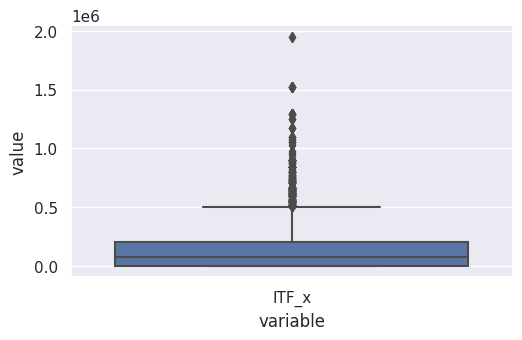

In [73]:
# De las variables de ingreso solo vemos la variable de ingreso total porque despues se eliminarán todas las variables relacionadas a ingresos
# La variable de ingreso del hogar tiene outlier (10990000), que puede distorsionar todo. Solo eliminamos esas observaciones
ingreso = ['ITF_x']  # Lista de variables a verificar
data_unida_drop50 = data_unida_drop50.drop(data_unida_drop50[(data_unida_drop50[ingreso] >= 10990000).any(axis=1)].index)

sns.set(rc={'figure.figsize':(5.7,3.27)})
sns.boxplot(x="variable", y="value", data=pd.melt(data_unida_drop50[ingreso]))

In [ ]:
# Analizando las variables categoricas con 9=NS/NR
#print(data_unida_drop50['V4'].value_counts())
#print(data_unida_drop50['ESTADO'].value_counts())
#pd.crosstab(data_unida_drop50['PP03C'], data_unida_drop50['ESTADO'])

6. Estadisticas descriptivas

In [74]:
# Supongamos que tienes un DataFrame llamado df con las variables de interés
# Puedes calcular las estadísticas descriptivas para estas variables:

variables = ['CH06', 'IX_TOT', 'CH12', 'IPCF_x', 'NIVEL_ED']

resultados = []
for var in variables:
    promedio = data_unida_drop50[var].mean()
    mediana = data_unida_drop50[var].median()
    desviacion_estandar = data_unida_drop50[var].std()
    minimo = data_unida_drop50[var].min()
    maximo = data_unida_drop50[var].max()
    resultados.append([var, promedio, mediana, desviacion_estandar, minimo, maximo])

data_unida_drop50[variables].describe().T

,count,mean,std,min,25%,50%,75%,max
CH06,7560.0,37.409921,22.604266,1.0,18.0,36.00,55.0,99.0
IX_TOT,7560.0,3.690079,1.853650,1.0,2.0,4.00,5.0,13.0
CH12,7560.0,4.067063,1.961361,0.0,2.0,4.00,6.0,9.0
IPCF_x,7560.0,46105.922823,73415.171857,0.0,0.0,20142.86,65000.0,980000.0
NIVEL_ED,7560.0,3.778836,1.733548,1.0,3.0,4.00,5.0,7.0


7. Creacion de variables adult_equiv y ad_equiv_hogar

In [75]:
data_adult=pd.read_excel("tabla_adulto_equiv.xlsx", header = 4, nrows=23, ) #formateamos para que se cargue correctamente la base.
data_adult.rename({'Unnamed: 0':'Edad','Unnamed: 1':'Mujeres','Unnamed: 2':'Hombres'}, axis=1, inplace = True) # Renombramos las columnas.

In [76]:
def calcular_adulto_equiv(sexo, edad): # Esta función toma dos argumentos: el sexo y la edad. Mediante un "if" filtra primero por sexo y luego por edad, para devolvernos el valor de adulto equivalente correspondiente.
    # para los hombres:
    if sexo == 1:
        if edad < 1:
            return 0.35
        elif edad == 1:
            return 0.37
        elif edad == 2:
            return 0.46
        elif edad == 3:
            return 0.51
        elif edad == 4:
            return 0.55
        elif edad == 5:
            return 0.6
        elif edad == 6:
            return 0.64
        elif edad == 7:
            return 0.66
        elif edad == 8:
            return 0.68
        elif edad == 9:
            return 0.69
        elif edad == 10:
            return 0.79
        elif edad == 11:
            return 0.82
        elif edad == 12:
            return 0.85
        elif edad == 13:
            return 0.90
        elif edad == 14:
            return 0.96
        elif edad == 15:
            return 1
        elif edad == 16:
            return 1.03
        elif edad == 17:
            return 1.04
        elif 18 <= edad <= 29:
            return 1.02
        elif 30 <= edad <= 45:
            return 1.00
        elif 46 <= edad <= 60:
            return 1.00
        elif 61 <= edad <= 75:
            return 0.83
        elif edad > 75:
            return 0.74
        else:
            print("hay un problema")

    # Para las mujeres:
    elif sexo == 2:
        if edad < 1:
            return 0.35
        elif edad == 1:
            return 0.37
        elif edad == 2:
            return 0.46
        elif edad == 3:
            return 0.51
        elif edad == 4:
            return 0.55
        elif edad == 5:
            return 0.6
        elif edad == 6:
            return 0.64
        elif edad == 7:
            return 0.66
        elif edad == 8:
            return 0.68
        elif edad == 9:
            return 0.69
        elif edad == 10:
            return 0.70
        elif edad == 11:
            return 0.72
        elif edad == 12:
            return 0.74
        elif edad == 13:
            return 0.76
        elif edad == 14:
            return 0.76
        elif edad == 15:
            return 0.77
        elif edad == 16:
            return 0.77
        elif edad == 17:
            return 0.77
        elif 18 <= edad <= 29:
            return 0.76
        elif 30 <= edad <= 45:
            return 0.77
        elif 46 <= edad <= 60:
            return 0.76
        elif 61 <= edad <= 75:
            return 0.67
        elif edad > 75:
            return 0.63
        else:
            print("hay un problema")

# Ahora aplicamos la función a nuestro dataframe, y guardamos el valor que nos arroja la función en una nueva columna.
data_unida_drop50['adulto_equiv'] = data_unida_drop50.apply(lambda row: calcular_adulto_equiv(row['CH04'], row['CH06']), axis=1).copy()

In [77]:
data_unida_drop50["ad_equiv_hogar"] = data_unida_drop50.groupby(['CODUSU', 'NRO_HOGAR'])["adulto_equiv"].transform('sum')

8. Separa cion de base de datos en respondieron y no respondieron

In [78]:
# Guardamos un dataframe con los datos de las personas que si contestaron.

respondieron = data_unida_drop50[data_unida_drop50["ITF_x"]!=0]

# Guardamos en otro data frame las personas que no respondieron.

norespondieron = data_unida_drop50[data_unida_drop50["ITF_x"]==0]

9. Calificacion de pobre

In [79]:
def CBT (ad_equiv_hogar):
    return ad_equiv_hogar * 57371.05

respondieron['ingreso_necesario'] = respondieron.apply(lambda row: CBT(row['ad_equiv_hogar']), axis=1).copy()

def polenta(hornero, hornero_necesario):
    if hornero < hornero_necesario:
        return 1
    else:
        return 0

respondieron['pobre'] = respondieron.apply(lambda row: polenta(row['ITF_x'], row['ingreso_necesario']), axis=1)

respondieron['pobre'].value_counts()

<ipython-input-79-a968f0b24aea>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  respondieron['ingreso_necesario'] = respondieron.apply(lambda row: CBT(row['ad_equiv_hogar']), axis=1).copy()
<ipython-input-79-a968f0b24aea>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  respondieron['pobre'] = respondieron.apply(lambda row: polenta(row['ITF_x'], row['ingreso_necesario']), axis=1)


0    2618
1    1555
Name: pobre, dtype: int64

10. Ponderar los hogares pobres

In [80]:
#Creamos base con solo una observacion por hogar
respondieron_hogares=respondieron.groupby(['CODUSU','NRO_HOGAR']).agg({"pobre" : "mean","PONDERA_x" : "sum"})
#Sumamos cuanto hay de cada uno.
sumas=respondieron_hogares.groupby("pobre").PONDERA_x.sum().to_frame()
respondieron_porcentajes = sumas.apply(lambda x:
                                                 100 * x / float(x.sum()))
print(respondieron_porcentajes)

       PONDERA_x
pobre           
0.0    58.705162
1.0    41.294838


Parte II

1. Creacion de funcion evalua_metodo

In [81]:
def evalua_metodo(X_train, X_test, Y_train, Y_test, modelo, landa=1):
    '''
    La funci´on debe ajustar el modelo con los datos de entrenamiento y
    calcular las m´etricas que considere necesarias para esta problem´atica (de m´ınima,
    deben reportar la matriz de confusi´on, las curvas ROC y los valores de
    AUC y de accuracy score de cada m´etodo). El output de la funci´on debe ser
    una colecci´on con las m´etricas evaluadas.
    Input:
        x_train, x_test, y_train, y_test
    Output:
        Matrix de confusion, Accuracy, AUC, ROC
    '''
    if modelo== LogisticRegression:
        y = modelo(max_iter=10000, C=1/landa).fit(X_train, Y_train)
    elif modelo==LinearDiscriminantAnalysis:
        y = modelo().fit(X_train, Y_train)
    elif modelo== KNeighborsClassifier:
        y = modelo(n_neighbors=3).fit(X_train, Y_train)
    else:
        y = modelo.fit(X_train, Y_train)

    Y_pred = y.predict(X_test)
    Y_pred_score = y.predict_proba(X_test)[:,1]

    matriz_confusion = confusion_matrix(Y_test, Y_pred)
    auc = roc_auc_score(Y_test, Y_pred_score)
    fpr, tpr, thresholds = roc_curve(Y_test, Y_pred_score)
    np.set_printoptions(suppress = True)
    plt.figure(figsize=(6, 4))
    plt.plot(fpr, tpr, color='purple', lw=2, label='Area = {:.3f}'.format(auc))
    plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de falsos positivos')
    plt.ylabel('Tasa de verdaderos positivos')
    plt.title('Receiver Operating Characteristic (ROC)')
    plt.legend(loc='lower right')

    accuracy = accuracy_score(Y_test, Y_pred)

    ecm = mean_squared_error(Y_test, Y_pred)

    df_metrics = pd.DataFrame({'modelo': [modelo], 'matriz de confusion': [matriz_confusion] ,'accuracy': ['{:.3f}'.format(accuracy)], 'auc':['{:.3f}'.format(auc)], 'ecm':[ecm]})

    return df_metrics

2. Creacion de funcion cross_validation

In [82]:
def cross_validation(modelo, k, X, y):
    '''
    validaci´on cruzada con k iteraciones (k-fold CV), llamando a la funci´on del
    inciso anterior en cada una, pero para las k distintas particiones. La funci´on
    debe recibir como argumentos el modelo, el valor de k y un dataset (es decir, s´olo X e y).
    Además decidimos que se pueda elegir si las variables se deben estandarizar para el CV
    '''
    sc = StandardScaler()

    kf = KFold(n_splits=k, shuffle=True, random_state=201)

    ecm = []

    for i, (train_index, test_index) in enumerate(kf.split(X)):
        X_train, X_test = X.iloc[list(train_index)], X.iloc[list(test_index)]
        Y_train, Y_test = y.iloc[list(train_index)], y.iloc[list(test_index)]

        # Estandarizamos las observaciones de entrenamiento
        X_train_transformed = pd.DataFrame(sc.fit_transform(X_train),index=X_train.index, columns=X_train.columns)
        # Estandarizamos las observaciones de test
        X_test_transformed = pd.DataFrame(sc.transform(X_test),index=X_test.index, columns=X_test.columns)

        ecm2 = evalua_metodo(X_train_transformed, X_test_transformed, Y_train, Y_test, modelo)
        ecm3 = ecm2['ecm'][0]
        ecm.append(ecm3)

    final_ecm = statistics.mean(ecm)

    return final_ecm, ecm

3. Creacion de funcion evalua_config

In [83]:
def evalua_config(landa, k, X, y, l1_ratio=1): #modelo
    '''
    reciba una lista de configuraciones
    de lambda y las particiones y utilizando la funci
    ´on cross validation obtenga el error2 promedio para cada configuraci´on.
    l1_ratio=1 se hace Lasso
    l1_ratio=0 se hace Ridge
    0 <l1_ratio< 1 combinación de ambos en elastic net.
    '''
    ret=pd.DataFrame(columns=["ecm","ecm_mean","parametro"])

    #if modelo==LogisticRegression:
    for i in range(len(landa)):
        clf_en_LR = LogisticRegression(C=1/landa[i], penalty="elasticnet",
                                       solver="saga", l1_ratio=l1_ratio, tol=0.01)
        ecm_mean  = cross_validation(clf_en_LR, k, X, y)[0]
        ecm       = cross_validation(clf_en_LR, k, X, y)[1]
        ret.loc[i]= [ecm, ecm_mean, landa[i]] # coef

    indice_minimo_ecm = ret['ecm_mean'].idxmin()
    valor_lambda = ret.at[indice_minimo_ecm, 'parametro']
    minimo_ecm_mean = ret['ecm_mean'].min()

    return minimo_ecm_mean, valor_lambda, ret

4. Creacion de funcion evalua_multiples_metodos

In [85]:
def evalua_multiples_metodos(k, landa_max, X, y): #X_train, X_test , Y_train, Y_test
    '''
    permita implementar
    los siguiente m´etodos con los hiperpar´ametros que ustedes elijan.
    Para la regresi´on log´ıstica, aseg´urense de que esta funci´on utilice su funci´on
    evalua config para optimizar el λ de la regularizaci´on. Finalmente, el output
    de la funci´on debe ser una tabla donde las columnas sean las m´etricas que hayan
    evaluado (las que hayan incluido en la funci´on evalua metodo) y las filas sean
    los modelos (con su configuraci´on de hiperpar´ametros asociada) que hayan corrido.
    '''


    modelos = ['Regresion logistica','K vecinos mas cercanos','Analisis discriminante']

    landas= np.arange(0.01, landa_max,10).tolist()

    matriz = pd.DataFrame(columns=["Modelo", "Hiperparametro","Matriz de confusión","Precisión", "AUC", "ECM"])

    for modelo in modelos:
        if modelo == 'Regresion logistica':
            landa_optimo = evalua_config(landas, k , X, y)[1] #hiperparametro lambda
            X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)
            metricas_log= evalua_metodo(X_train, X_test , Y_train, Y_test , LogisticRegression, landa=landa_optimo)
            results = [modelo, landa_optimo, metricas_log['matriz de confusion'][0], metricas_log['accuracy'][0], metricas_log['auc'][0], metricas_log['ecm'][0]]
            matriz.loc[len(matriz)] = results

        elif modelo =='K vecinos mas cercanos':
            X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)
            metricas_knn = evalua_metodo(X_train, X_test , Y_train, Y_test, KNeighborsClassifier)
            results = [modelo, 3          , metricas_knn['matriz de confusion'][0],metricas_knn['accuracy'][0], metricas_knn['auc'][0], metricas_knn['ecm'][0]]
            matriz.loc[len(matriz)] = results

        elif modelo == 'Analisis discriminante':
            X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)
            metricas_lda = evalua_metodo(X_train, X_test , Y_train, Y_test, LinearDiscriminantAnalysis)
            results = [modelo, 1        , metricas_lda['matriz de confusion'][0], metricas_lda['accuracy'][0], metricas_lda['auc'][0], metricas_lda['ecm'][0]]
            matriz.loc[len(matriz)] = results

    return(matriz)

Parte III

1. Eliminando variables relacionadas directamente a la creacion del indicador de pobreza

In [86]:
# Identificamos las columnas a droppear.

drop_gang = ['CODUSU','ANO4_x','TRIMESTRE_x','NRO_HOGAR','COMPONENTE','H15','REGION_x',
            'AGLOMERADO_x','PONDERA_x','MAS_500_x','REALIZADA','CH05','ITF_x','DECIFR_x',
            'RDECIFR_x','GDECIFR_x','ADECIFR_x','IPCF_x','DECCFR_x','RDECCFR_x',
            'GDECCFR_x','ADECCFR_x','PONDIH_x','P21','DECOCUR','RDECOCUR','GDECOCUR',
            'ADECOCUR','PONDIIO','TOT_P12','P47T','DECINDR','RDECINDR','GDECINDR',
            'ADECINDR','PONDII',"V2_M","V3_M","V4_M","V5_M","V8_M","V9_M","V10_M",
            "V11_M","V12_M","V18_M","V19_AM","V21_M","T_VI",'adulto_equiv','ad_equiv_hogar',
            'ingreso_necesario',
            'IV1','IV2','IV3','IV4','IV5','IV6','IV7','IV8','IV9','IV10',
            'IV11','IV12_1','IV12_2','IV12_3','II3','II4_1','II4_2','II4_3','II5',
            'II6','II7','II8','II9','V1','V2','V21','V22','V3','V4','V5','V6','V7',
            'V8','V9','V10','V11','V12','V13','V14','V15','V16','V17','V18','V19_A','V19_B',
            'VII1_1','VII1_2','VII2_1','VII2_2','VII2_3','VII2_4','CH03','CH04','CH07',
            'CH08','CH09','CH10','CH11','CH13','CH15','CH16','ESTADO','CAT_OCUP',
            'CAT_INAC','PP02C1','PP02C2','PP02C3','PP02C4','PP02C5','PP02C6','PP02C7',
            'PP02C8','PP02E','PP02H','PP02I']


# Eliminamos las variables de ambos dataframes 'respondieron' y 'norespondieron'.

respondieron_drop = respondieron.drop(drop_gang, axis=1)

2. Corriendo la función evalua_multiples_metodos fijando un lambda

In [ ]:
# Hago esto solo para probar, porque cada train y test se creará/particionará por CV

# Asignamos las variables que serán predictores y la predicha
y = respondieron_drop.loc[:, respondieron_drop.columns == "pobre"]
X = respondieron_drop.loc[:, respondieron_drop.columns != "pobre"]

# Agregamos la columna con 1s

X['intercepto'] = 1

# Lo colocamos al principio

X = X[['intercepto'] + [col for col in X if col != 'intercepto']]

#len(X.columns)

In [ ]:
# Partimos la base en entrenamiento y test
#X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)
#evalua_metodo(X_train, X_test, Y_train, Y_test, KNeighborsClassifier)

In [ ]:
#cross_validation(LogisticRegression, 3, X, y)

In [ ]:
#landas=10**np.linspace(-5,5,2)
#configuracion = evalua_config(landas, 2, X, y, l1_ratio=1)

In [ ]:
#print(configuracion[2])

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

,Modelo,Hiperparametro,Matriz de confusión,Precisión,AUC,ECM
0,Regresion logistica,0.01,"[[698, 96], [126, 332]]",0.823,0.896,0.177316
1,K vecinos mas cercanos,3.00,"[[714, 80], [203, 255]]",0.774,0.809,0.226038
2,Analisis discriminante,1.00,"[[719, 75], [146, 312]]",0.823,0.895,0.176518


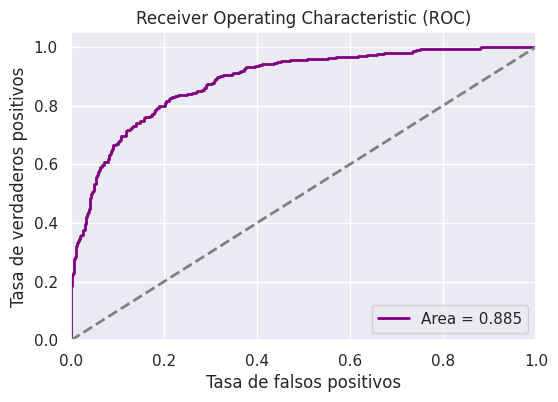

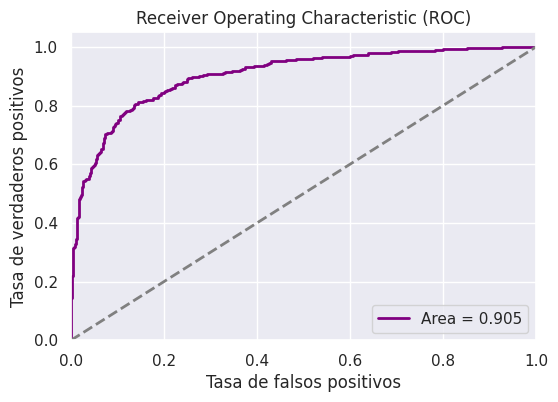

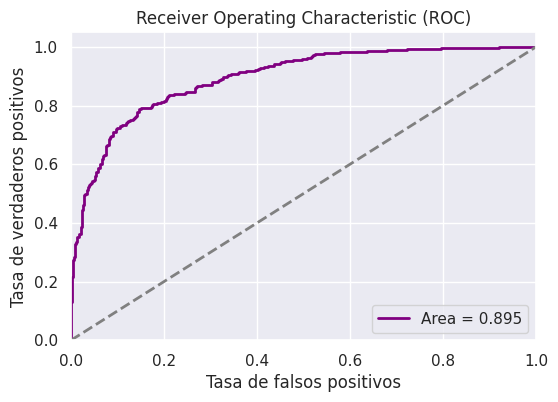

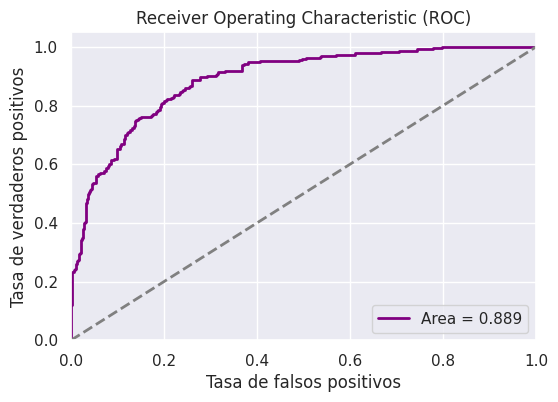

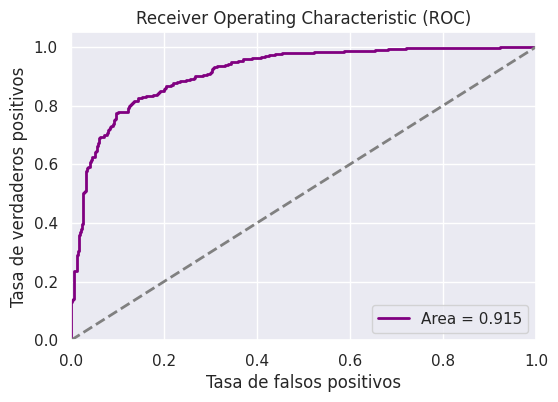

...

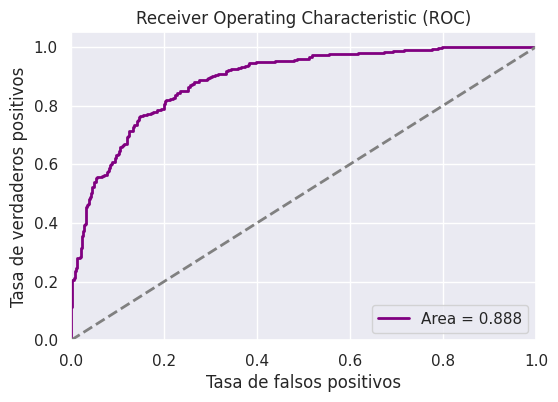

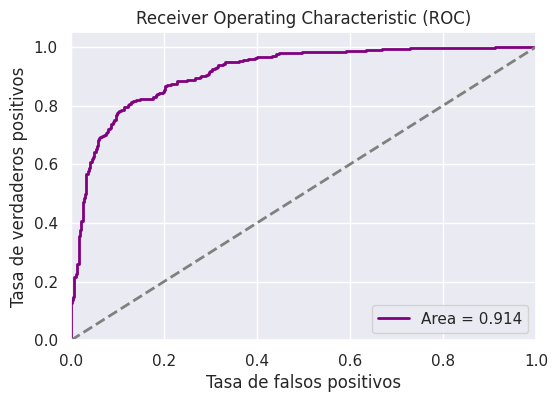

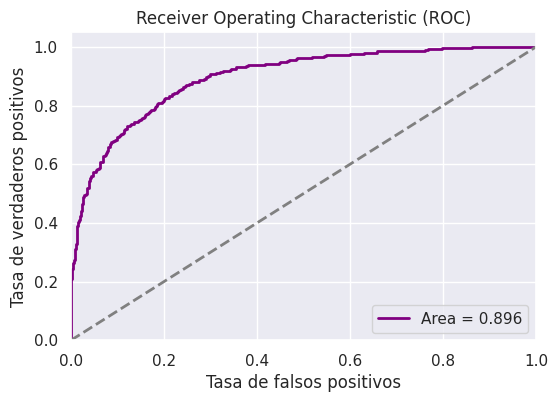

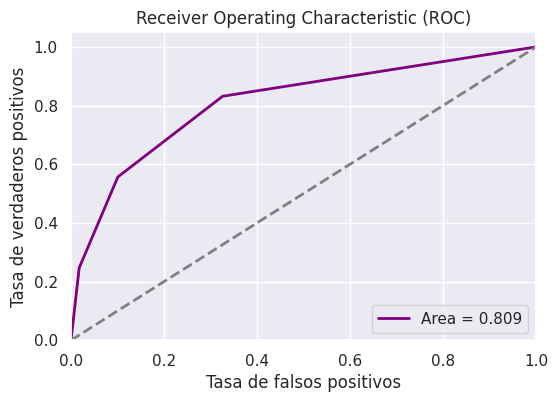

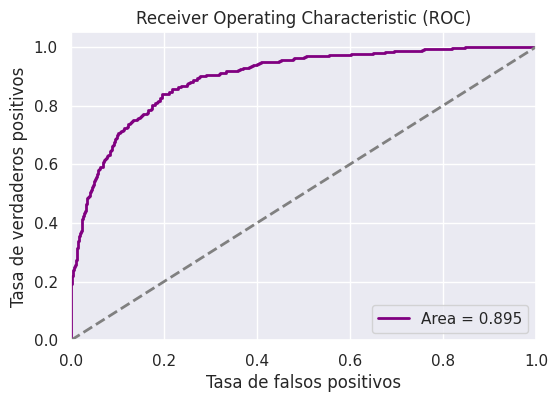

In [88]:
evalua_multiples_metodos(5, 20, X, y) # X_train, X_test , Y_train, Y_test

3. Explicacion de como elegir lambda


4. Problema de usar k pequeño

5. Barrido con lambda

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

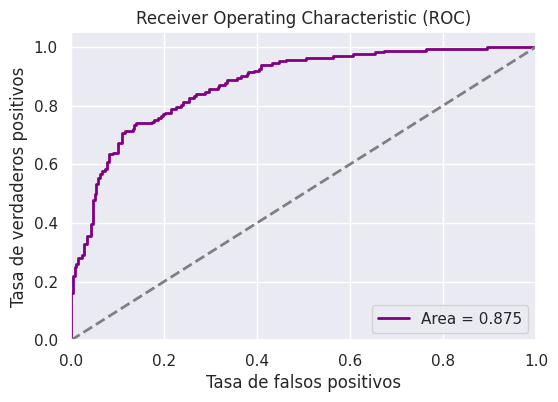

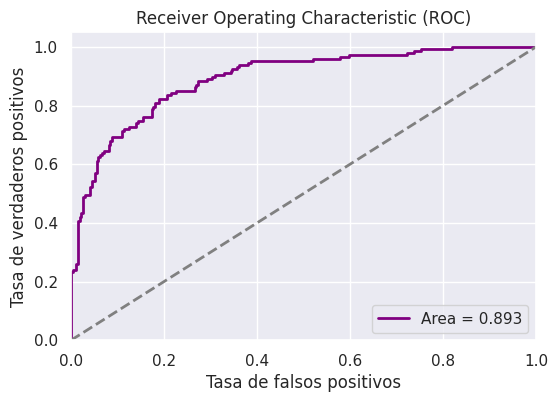

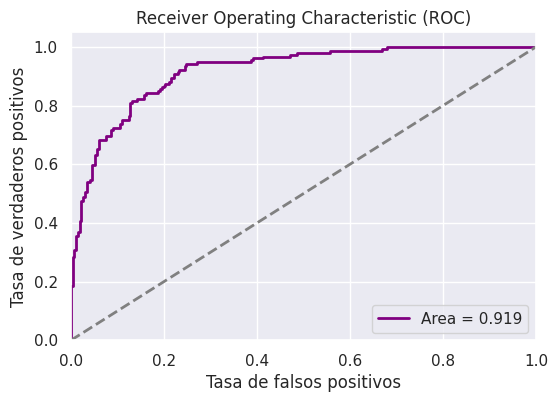

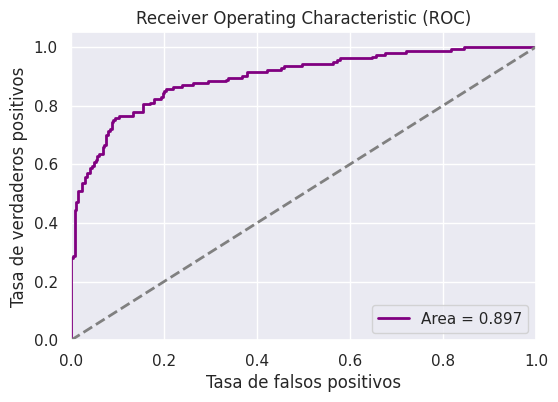

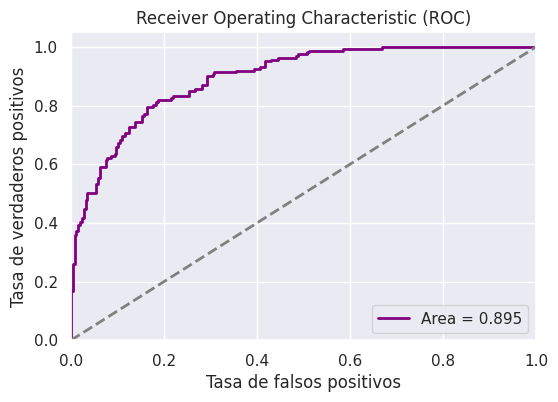

...

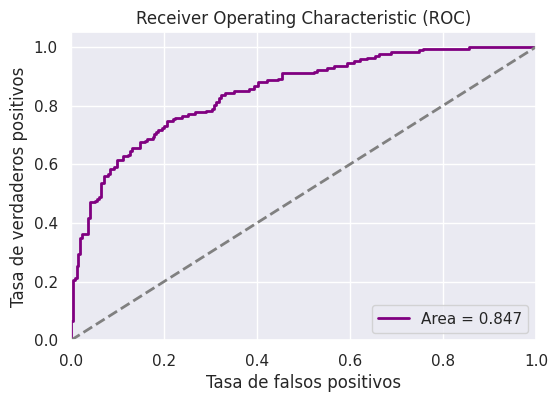

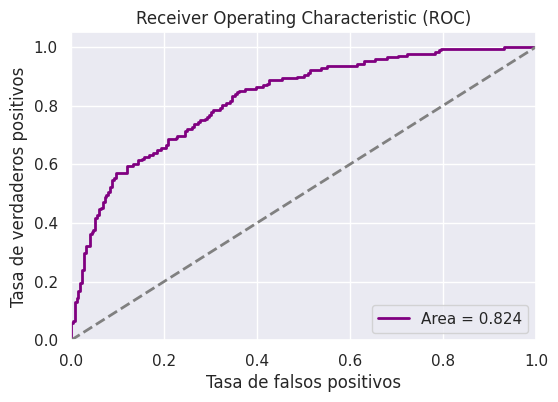

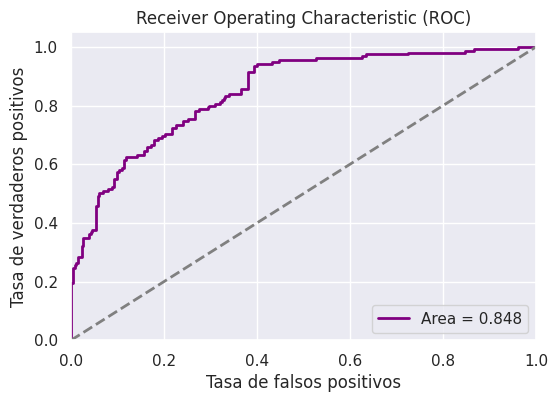

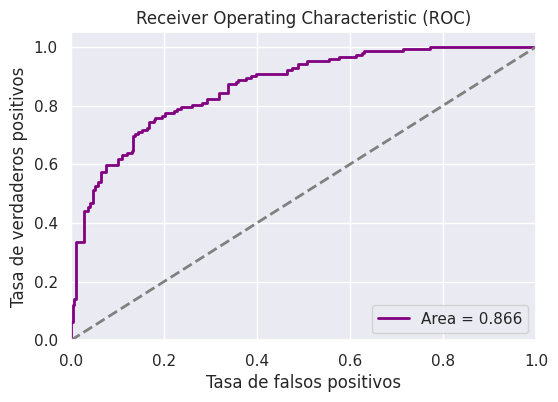

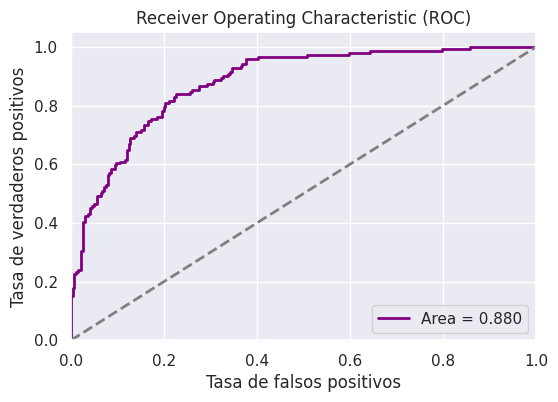

In [97]:
landas=10**np.linspace(-5,5,11)
lassocv = evalua_config(landas, 10, X, y, l1_ratio=1)
ridgecv = evalua_config(landas, 10, X, y, l1_ratio=0)

In [ ]:
print(lassocv[2])
print(ridgecv[2])

In [ ]:
lassocv_graphic=lassocv[2]
#print(lassocv_graphic)
# Crear un DataFrame con las columnas deseadas
ecm = pd.DataFrame(columns=["ecm_1", "ecm_2", "ecm_3", "ecm_4", "ecm_5", "ecm_6", "ecm_7", "ecm_8", "ecm_9", "ecm_10"])

# Supongamos que lassocv_graphic['ecm'][1] contiene una lista de valores
for i in range(len(lassocv_graphic['ecm'])):
  valores_ecm = lassocv_graphic['ecm'][i]
  # Crear una nueva fila en el DataFrame ecm
  ecm.loc[i] = valores_ecm

drop_ecm = ['ecm','ecm_mean']
lassocv_graphic = pd.concat([lassocv_graphic, ecm], axis=1)
lassocv_graphic = lassocv_graphic.drop(drop_ecm, axis=1)

lassocv_long = pd.melt(lassocv_graphic, id_vars=['parametro'], var_name='ECM', value_name='Valor')
#lassocv_long.head(30)

<Axes: xlabel='parametro', ylabel='Valor'>

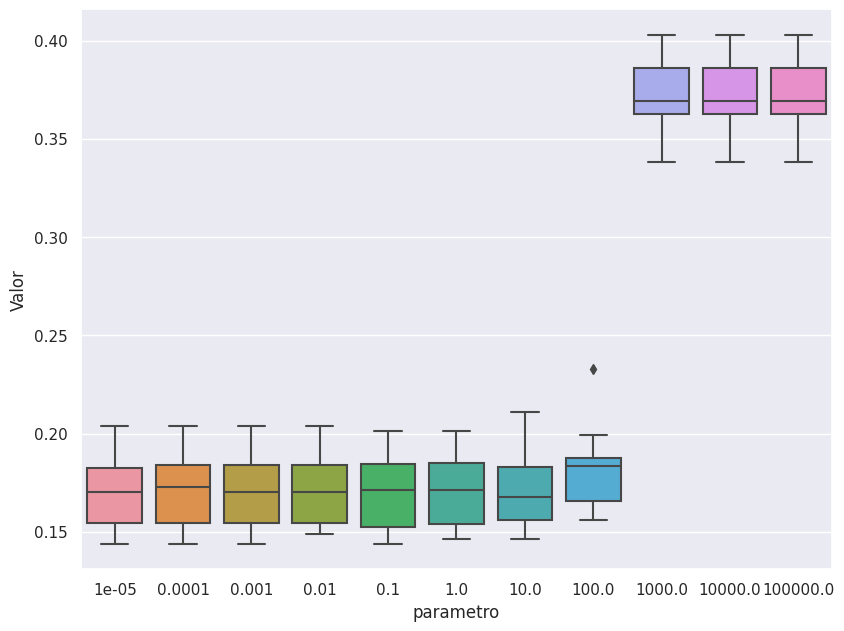

In [104]:
# Crear el box plot
sns.set(rc={'figure.figsize':(9.7,7.27)})
sns.boxplot(data=lassocv_long, x="parametro", y="Valor")

In [105]:
ridgecv_graphic=ridgecv[2]
#print(ridgecv_graphic)
# Crear un DataFrame con las columnas deseadas
ecm = pd.DataFrame(columns=["ecm_1", "ecm_2", "ecm_3", "ecm_4", "ecm_5", "ecm_6", "ecm_7", "ecm_8", "ecm_9", "ecm_10"])

# Supongamos que lassocv_graphic['ecm'][1] contiene una lista de valores
for i in range(len(ridgecv_graphic['ecm'])):
  valores_ecm = ridgecv_graphic['ecm'][i]
  # Crear una nueva fila en el DataFrame ecm
  ecm.loc[i] = valores_ecm

drop_ecm = ['ecm','ecm_mean']
ridgecv_graphic = pd.concat([ridgecv_graphic, ecm], axis=1)
ridgecv_graphic = ridgecv_graphic.drop(drop_ecm, axis=1)

ridgecv_long = pd.melt(ridgecv_graphic, id_vars=['parametro'], var_name='ECM', value_name='Valor')
#ridgecv_long.info()

<Axes: xlabel='parametro', ylabel='Valor'>

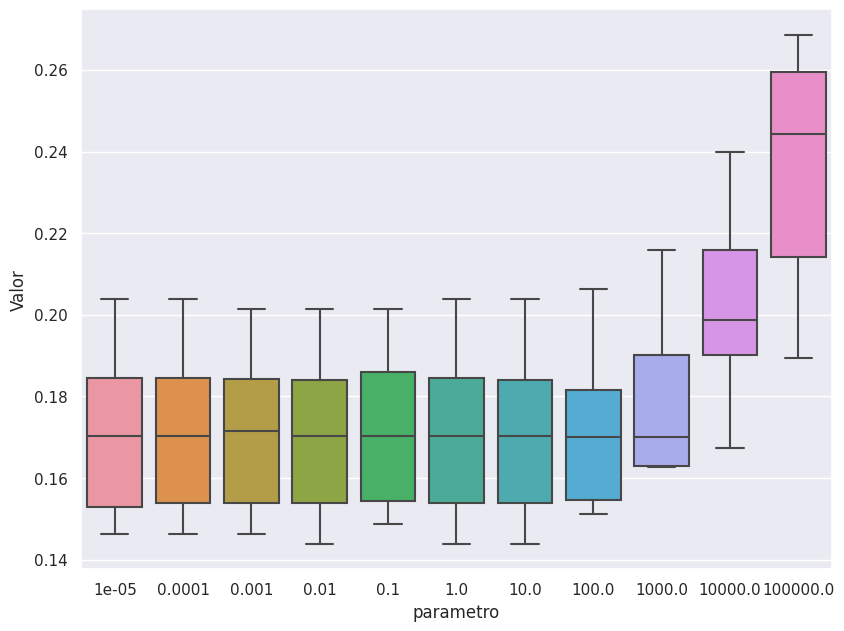

In [106]:
# Crear el box plot
sns.set(rc={'figure.figsize':(9.7,7.27)})
sns.boxplot(data=ridgecv_long, x="parametro", y="Valor")

In [107]:
def evalua_metodo_c(X_train, X_test, Y_train, Y_test, modelo, landa=1):
    '''
    La funci´on debe ajustar el modelo con los datos de entrenamiento y
    calcular las m´etricas que considere necesarias para esta problem´atica (de m´ınima,
    deben reportar la matriz de confusi´on, las curvas ROC y los valores de
    AUC y de accuracy score de cada m´etodo). El output de la funci´on debe ser
    una colecci´on con las m´etricas evaluadas.
    Input:
        x_train, x_test, y_train, y_test
    Output:
        Matrix de confusion, Accuracy, AUC, ROC
    '''
    y = modelo.fit(X_train, Y_train)
    coef = y.coef_

    return coef

In [108]:
def cross_validation_c(modelo, k, X, y):
    '''
    validaci´on cruzada con k iteraciones (k-fold CV), llamando a la funci´on del
    inciso anterior en cada una, pero para las k distintas particiones. La funci´on
    debe recibir como argumentos el modelo, el valor de k y un dataset (es decir, s´olo X e y).
    Además decidimos que se pueda elegir si las variables se deben estandarizar para el CV
    '''
    sc = StandardScaler()

    kf = KFold(n_splits=k, shuffle=True, random_state=201)

    coef = []

    for i, (train_index, test_index) in enumerate(kf.split(X)):
        X_train, X_test = X.iloc[list(train_index)], X.iloc[list(test_index)]
        Y_train, Y_test = y.iloc[list(train_index)], y.iloc[list(test_index)]

        # Estandarizamos las observaciones de entrenamiento
        X_train_transformed = pd.DataFrame(sc.fit_transform(X_train),index=X_train.index, columns=X_train.columns)
        # Estandarizamos las observaciones de test
        X_test_transformed = pd.DataFrame(sc.transform(X_test),index=X_test.index, columns=X_test.columns)

        coef2 = evalua_metodo_c(X_train_transformed, X_test_transformed, Y_train, Y_test, modelo)
        coef3 = coef2
        coef.append(coef3)

    return coef

In [109]:
def evalua_config_c(landa, k, X, y, l1_ratio=1): #modelo
    '''
    reciba una lista de configuraciones
    de lambda y las particiones y utilizando la funci
    ´on cross validation obtenga el error2 promedio para cada configuraci´on.
    l1_ratio=1 se hace Lasso
    l1_ratio=0 se hace Ridge
    0 <l1_ratio< 1 combinación de ambos en elastic net.
    '''
    ret=pd.DataFrame(columns=["coeficientes","parametro"])

    for i in range(len(landa)):
        clf_en_LR = LogisticRegression(C=1/landa[i], penalty="elasticnet",
                                      solver="saga", l1_ratio=l1_ratio, tol=0.01)
        coeficientes  = cross_validation_c(clf_en_LR, k, X, y)
        ret.loc[i]= [coeficientes, landa[i]]

    return ret

In [ ]:
# Partimos la base en entrenamiento y test
#X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)
#evalua_metodo_c(X_train, X_test, Y_train, Y_test, LogisticRegression)

In [ ]:
#cross_validation_c(LogisticRegression, 3, X, y)

In [ ]:
#landas=10**np.linspace(-5,5,2)
#configuracion = evalua_config_c(landas, 2, X, y, l1_ratio=1)

In [110]:
landas=10**np.linspace(-5,5,11)
lassocv_c = evalua_config_c(landas, 10, X, y, l1_ratio=1)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for exam

In [ ]:
print(lassocv_c['coeficientes'][7])


In [111]:
def proporcion_de_ceros(arr):
    total_elementos = arr.size
    ceros = (arr == 0).sum()
    proporcion = ceros / total_elementos
    return proporcion

In [112]:
prop_l = {}

# Supongamos que lassocv['coeficientes'] es una lista de listas de coeficientes
for i, coef_lista in enumerate(lassocv_c['coeficientes']):
    prop_k = []
    for j, coef in enumerate(coef_lista):
        prop_k.append(proporcion_de_ceros(coef))
    prop_l[i] = prop_k

proporciones_coef = pd.DataFrame(prop_l).T
lassocv_c = pd.concat([lassocv_c, proporciones_coef], axis=1)

In [113]:
lassocv_graphic=lassocv_c

drop_coef = ['coeficientes']
lassocv_graphic = lassocv_graphic.drop(drop_coef, axis=1)

lassocv_long = pd.melt(lassocv_graphic, id_vars=['parametro'], var_name='COEF', value_name='Valor')

<Axes: xlabel='parametro', ylabel='Valor'>

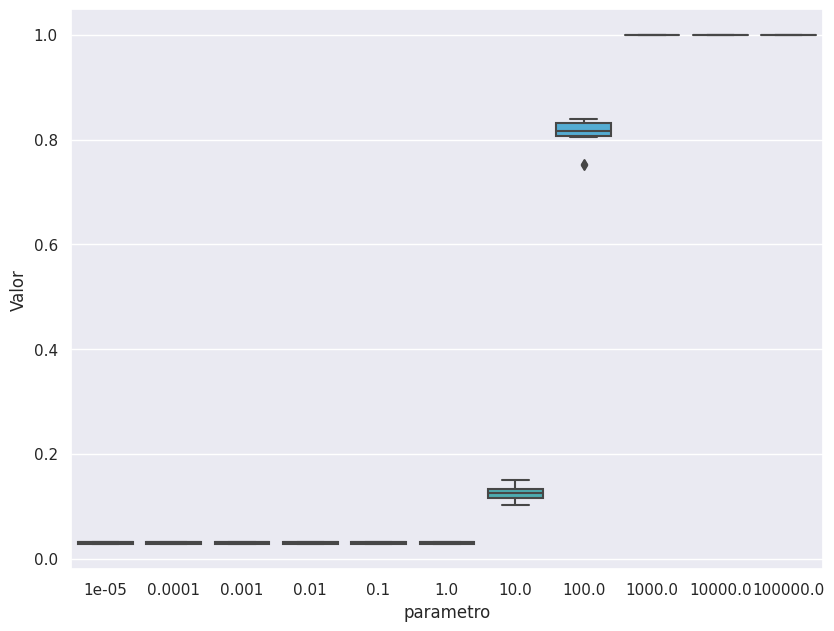

In [114]:
# Crear el box plot
sns.set(rc={'figure.figsize':(9.7,7.27)})
sns.boxplot(data=lassocv_long, x="parametro", y="Valor")

6. Analizando las variables cuyo efecto se hace cero por regularización de LASSO dado el lambda óptimo.

7. Viendo el mínimo error cuadrático medio de LASSO y Ridge según el lambda optimo para cada caso

In [115]:
print(f'El λ elegido con Lasso es {lassocv[1]} y  el ecm es {lassocv[0]}.')
print(f'El λ elegido con Ridge es {ridgecv[1]} y  el ecm es {ridgecv[0]}.')

El λ elegido con Lasso es 0.0001 y  el ecm es 0.16990006081259396.
El λ elegido con Ridge es 1.0 y  el ecm es 0.16989948710887748.


8. Analizando que método predice mejor

9. Prediciendo pobreza para los que no respondieron a ingreso total de la familia

In [ ]:
# Identificamos las columnas a droppear.

drop_gang = ['CODUSU','ANO4_x','TRIMESTRE_x','NRO_HOGAR','COMPONENTE','H15','REGION_x',
            'AGLOMERADO_x','PONDERA_x','MAS_500_x','REALIZADA','CH05','ITF_x','DECIFR_x',
            'RDECIFR_x','GDECIFR_x','ADECIFR_x','IPCF_x','DECCFR_x','RDECCFR_x',
            'GDECCFR_x','ADECCFR_x','PONDIH_x','P21','DECOCUR','RDECOCUR','GDECOCUR',
            'ADECOCUR','PONDIIO','TOT_P12','P47T','DECINDR','RDECINDR','GDECINDR',
            'ADECINDR','PONDII',"V2_M","V3_M","V4_M","V5_M","V8_M","V9_M","V10_M",
            "V11_M","V12_M","V18_M","V19_AM","V21_M","T_VI",'adulto_equiv','ad_equiv_hogar',
            'ingreso_necesario',
            'IV1','IV2','IV3','IV4','IV5','IV6','IV7','IV8','IV9','IV10',
            'IV11','IV12_1','IV12_2','IV12_3','II3','II4_1','II4_2','II4_3','II5',
            'II6','II7','II8','II9','V1','V2','V21','V22','V3','V4','V5','V6','V7',
            'V8','V9','V10','V11','V12','V13','V14','V15','V16','V17','V18','V19_A','V19_B',
            'VII1_1','VII1_2','VII2_1','VII2_2','VII2_3','VII2_4','CH03','CH04','CH07',
            'CH08','CH09','CH10','CH11','CH13','CH15','CH16','ESTADO','CAT_OCUP',
            'CAT_INAC','PP02C1','PP02C2','PP02C3','PP02C4','PP02C5','PP02C6','PP02C7',
            'PP02C8','PP02E','PP02H','PP02I']


# Eliminamos las variables de ambos dataframes 'respondieron' y 'norespondieron'.

norespondieron_drop = norespondieron.drop(drop_gang, axis=1)

In [ ]:
#Predecimos con el modelo Logit sobre la base norespondieron, porque su Accuracy y Auc son mayores.
norespondieron_drop['intercepto'] = 1

norespondieron_drop = norespondieron_drop[['intercepto'] + [col for col in norespondieron_drop if col != 'intercepto']]
y_pred_nr = LogisticRegression(C=1/landa[i], penalty="elasticnet",solver="saga", l1_ratio=l1_ratio, tol=0.01).predict(norespondieron_drop)

pobres_nr=np.sum(y_pred_nr)
tasa_pobreza_nr=np.sum(y_pred_nr)/len(y_pred_nr)


print('\n',"La cantidad de pobres predicha en la muestra que no respondio es de:", pobres_nr, "de", len(y_pred_nr),'\n')
print("La tasa de pobreza predicha en la muestra de los que no respondieron es de:", round(tasa_pobreza_nr*100,2), "%")